<a href="https://colab.research.google.com/github/yingzibu/MOL2ADMET/blob/main/examples/experiments/VAE/VAE_only_on_data_M5_11_08.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
! pip install PyTDC --quiet
! pip install selfies  --quiet
! pip install pubchempy --quiet
! pip install rdkit --quiet
! pip install mycolorpy --quiet
! pip install dgllife --quiet
! pip install molvs --quiet
! pip install dgl -f https://data.dgl.ai/wheels/cu118/repo.html --quiet
! pip install dglgo -f https://data.dgl.ai/wheels-test/repo.html --quiet

! pip install DeepPurpose --quiet
! pip install git+https://github.com/bp-kelley/descriptastorus --quiet
! pip install pandas-flavor --quiet

## Code

In [ ]:
cd /content/drive/MyDrive/ADMET

/content/drive/MyDrive/ADMET


In [ ]:
from scripts.func_utils import *
from scripts.yaml_utils import *
from scripts.eval_utils import *
from scripts.preprocess_mols import *
from scripts.model_architecture import *
from scripts.dataset import *
from scripts.train import *
from tdc.utils import retrieve_label_name_list
import pandas as pd
from scripts.get_vocab import *

from tdc.single_pred import ADME
from tdc.single_pred import Tox
label_list = retrieve_label_name_list('herg_central')


Vocab type for RNN: smiles


## Train M5

In [ ]:
names = names_M5

vocab_type = 'smiles'
trn, val, tst = collect_data(names)
config = get_config('VAE', names, scale_dict=None, vocab_type=vocab_type)
path_here = f'M5/VAE_{vocab_type}'
config['model_path'] = f'{path_here}.pt'
config['encoder_path'] = f'{path_here}_encoder.pt'
config['decoder_path'] = f'{path_here}_decoder.pt'
config['classifier_path'] = f'{path_here}_classifier.pt'
config['config_path'] = f'{path_here}.yml'
config['figure_path'] = f'{path_here}/fig'
config['MAX_EPOCH'] = 100
config['patience'] = 10
config['verbose_freq'] = 10
config['uw'] = True
trn_l, val_l, tst_l, vocab = get_multi_loader(trn, val, tst, config)

# models.load_model('VAE/qed_sa.pt') # load model from pretrained on qed and sa


Found local copy...
Loading...
Done!
Found local copy...
Loading...
Done!


collect data for:  ['CYP2C19_Veith', 'CYP2D6_Veith', 'CYP3A4_Veith', 'CYP1A2_Veith', 'CYP2C9_Veith']


Found local copy...
Loading...
Done!
Found local copy...
Loading...
Done!
Found local copy...
Loading...
Done!


---> loader for ['CYP2C19_Veith', 'CYP2D6_Veith', 'CYP3A4_Veith', 'CYP1A2_Veith', 'CYP2C9_Veith']
--> preparing data loader for model type  VAE
--> preparing data loader for model type  VAE
--> preparing data loader for model type  VAE


In [ ]:
models = PRED(**config)

Model type:  VAE | Model parameters:  7889067


Start training VAE...


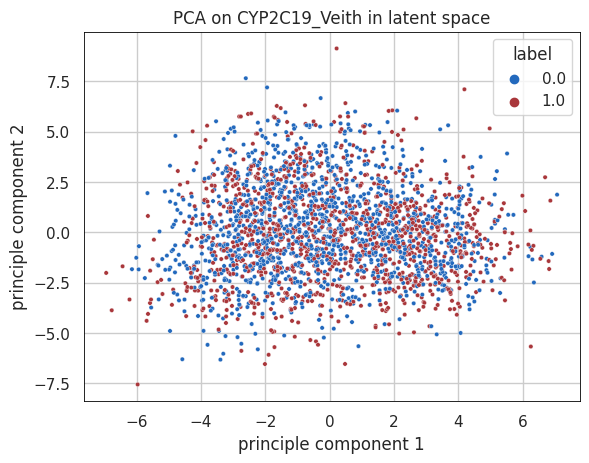

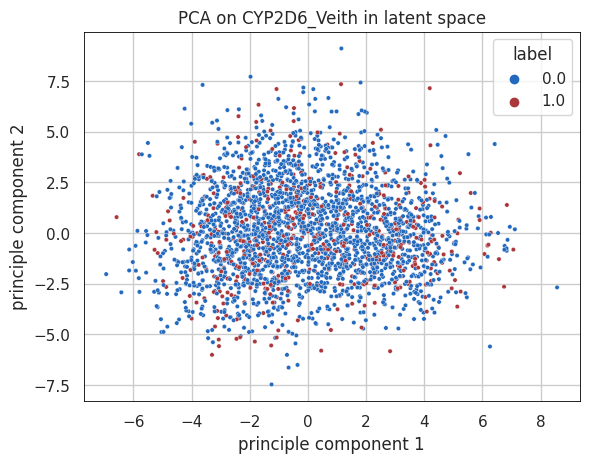

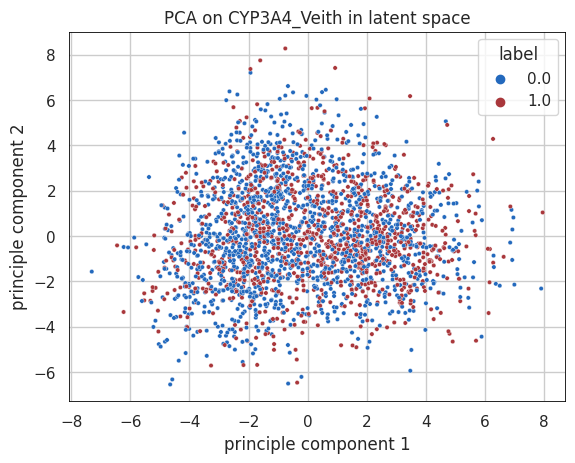

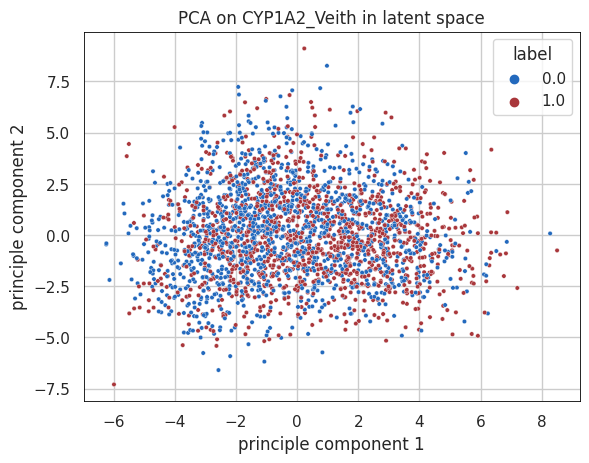

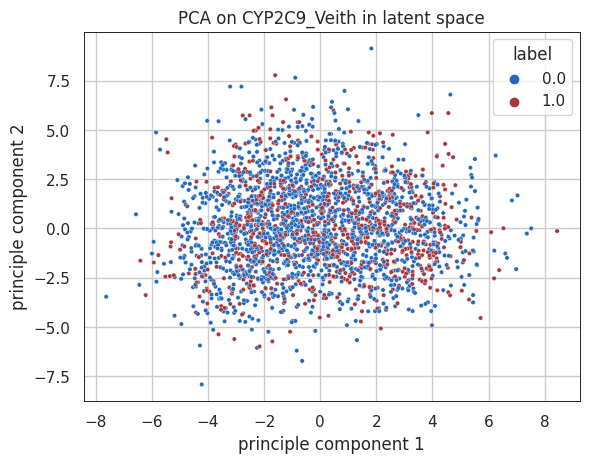

Epoch:0 [Train] Loss: 3.313 | KL Div: 408.584 | Recon: 2.664 | Classify: 0.650 | KL w: 0.000 | cls w: 1.000
Epoch:0 [Valid] Loss: 3.143 | KL Div: 467.360 | Recon: 2.505 | Classify: 0.638 | KL w: 0.000 | cls w: 1.000
## SAVE Enc, Dec, Cls: classify loss: inf -> 0.638 | # SAVE MODEL: loss: inf -> 3.143 | runtime: 2.555 ms
Epoch:1 [Train] Loss: 3.266 | KL Div: 12.151 | Recon: 2.557 | Classify: 0.648 | KL w: 0.005 | cls w: 1.000
Epoch:1 [Valid] Loss: 3.081 | KL Div: 1.264 | Recon: 2.438 | Classify: 0.637 | KL w: 0.005 | cls w: 1.000
## SAVE Enc, Dec, Cls: classify loss: 0.638 -> 0.637 | # SAVE MODEL: loss: 3.143 -> 3.081 | runtime: 2.521 ms
Epoch:2 [Train] Loss: 2.494 | KL Div: 0.690 | Recon: 1.853 | Classify: 0.635 | KL w: 0.010 | cls w: 1.000
Epoch:2 [Valid] Loss: 2.131 | KL Div: 0.757 | Recon: 1.517 | Classify: 0.606 | KL w: 0.010 | cls w: 1.000
## SAVE Enc, Dec, Cls: classify loss: 0.637 -> 0.606 | # SAVE MODEL: loss: 3.081 -> 2.131 | runtime: 2.512 ms
Epoch:3 [Train] Loss: 1.986 | KL 

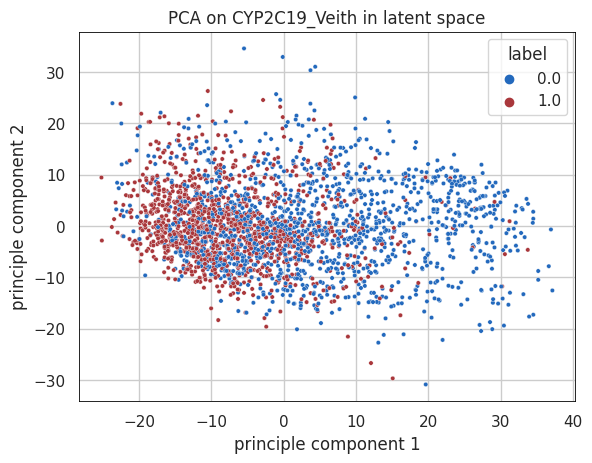

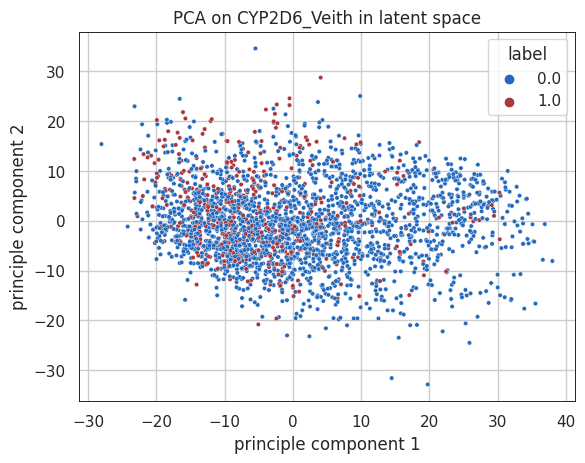

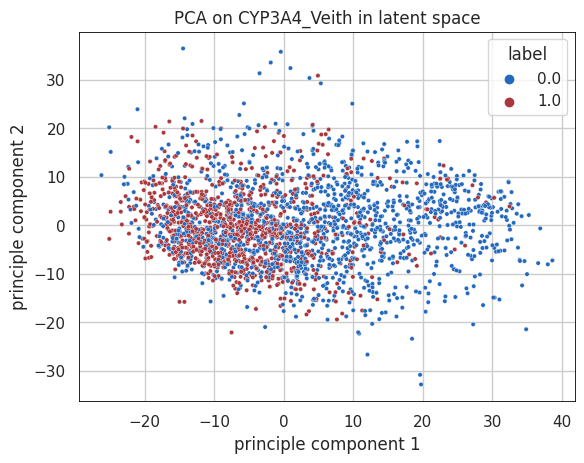

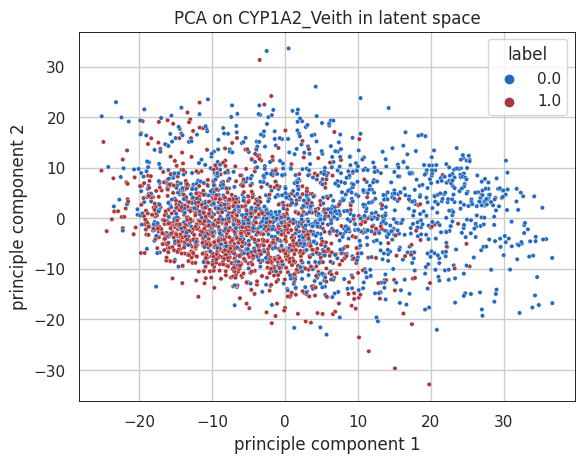

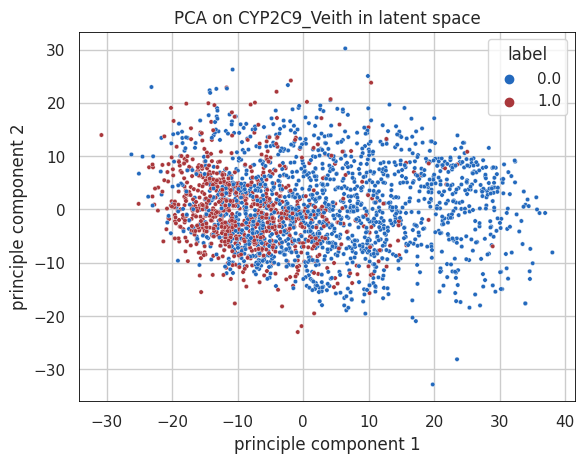

Epoch:10 [Train] Loss: 1.382 | KL Div: 0.063 | Recon: 0.848 | Classify: 0.531 | KL w: 0.050 | cls w: 1.000
Epoch:10 [Valid] Loss: 1.344 | KL Div: 0.063 | Recon: 0.810 | Classify: 0.530 | KL w: 0.050 | cls w: 1.000
## SAVE Enc, Dec, Cls: classify loss: 0.540 -> 0.530 | # SAVE MODEL: loss: 1.394 -> 1.344 | runtime: 2.548 ms
Train time: 2.559+/-0.033 ms


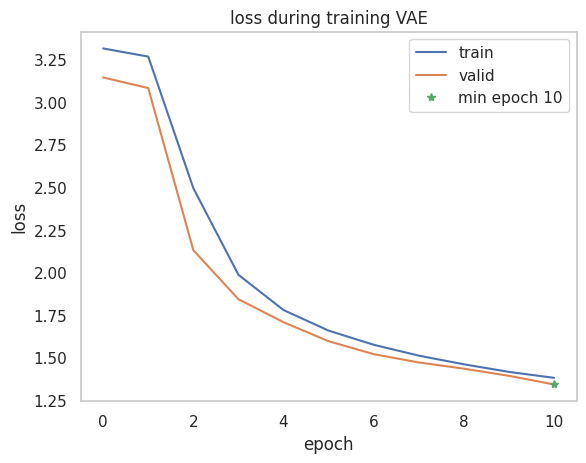

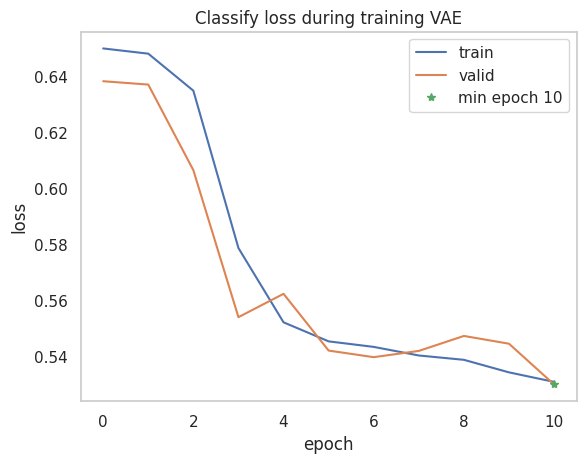

*************** CYP2C19_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.733  &0.737  &0.683  &0.801  &0.673  &0.738 &0.804 &0.475 &0.749

*************** CYP2D6_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.802  &0.500  &  nan  &0.000  &1.000  &  nan &0.669 &  nan &0.326

*************** CYP3A4_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.688  &0.694  &0.604  &0.734  &0.654  &0.663 &0.755 &0.383 &0.624

*************** CYP1A2_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.678  &0.687  &0.617  &0.799  &0.575  &0.696 &0.760 &0.379 &0.691

*************** CYP2C9_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.739  &0.732  &0.600  &0.709  &0.755  &0.650 &0.811 &0.449 &0.656

Epoch:11 [Train] Loss: 1.349 | KL Div: 0.064 | Recon: 0.820 | Classify: 0.526 | KL w: 0.055 | cls w

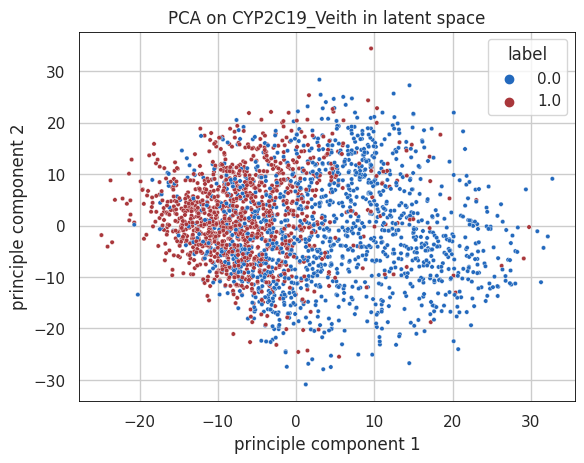

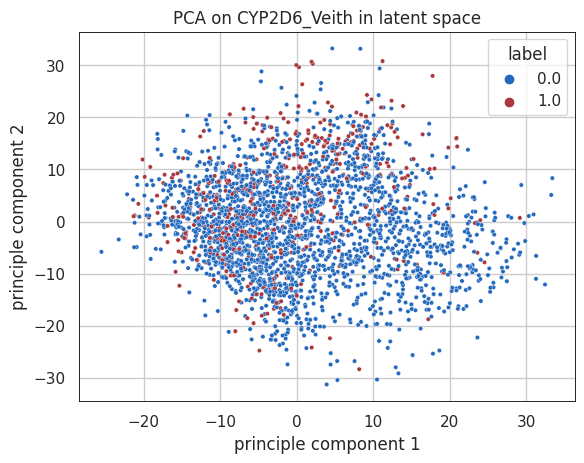

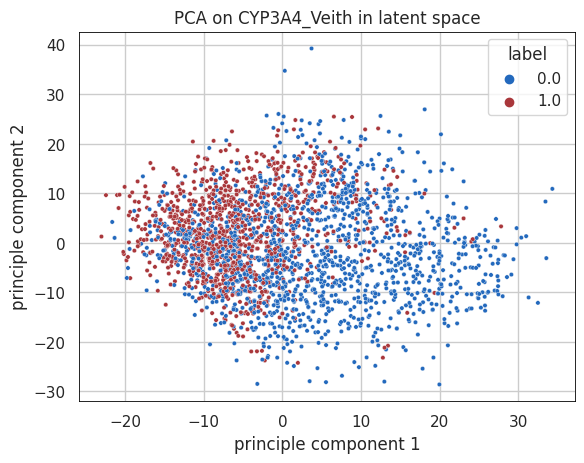

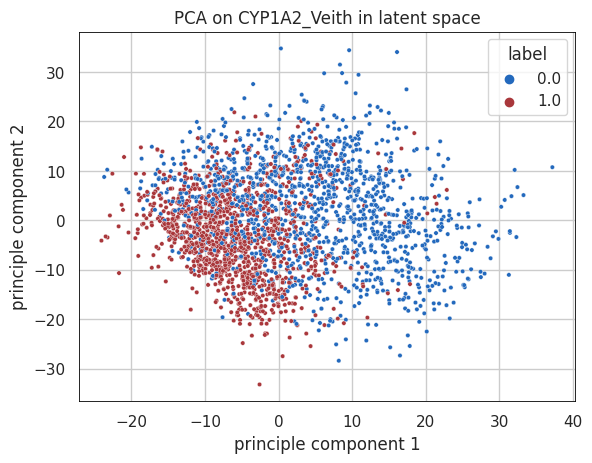

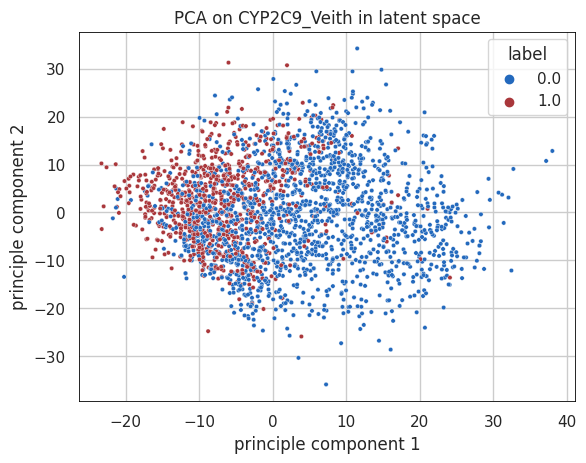

Epoch:20 [Train] Loss: 1.177 | KL Div: 0.050 | Recon: 0.680 | Classify: 0.492 | KL w: 0.100 | cls w: 1.000
Epoch:20 [Valid] Loss: 1.162 | KL Div: 0.038 | Recon: 0.661 | Classify: 0.497 | KL w: 0.100 | cls w: 1.000
## SAVE Enc, Dec, Cls: classify loss: 0.498 -> 0.497 | # SAVE MODEL: loss: 1.163 -> 1.162 | runtime: 2.575 ms
Train time: 2.567+/-0.029 ms


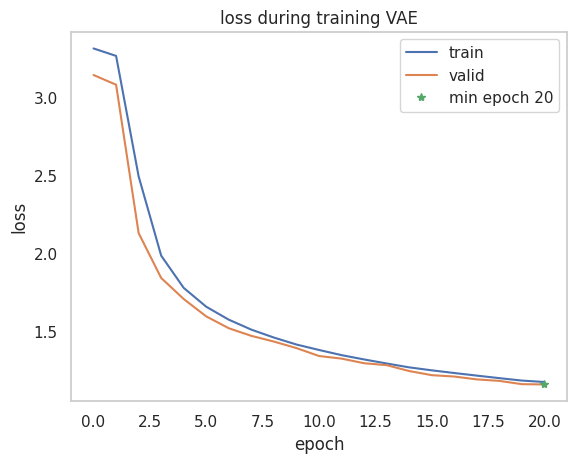

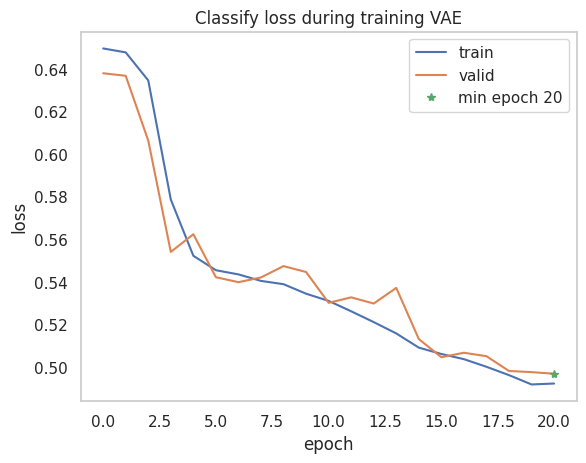

*************** CYP2C19_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.757  &0.755  &0.745  &0.730  &0.780  &0.738 &0.831 &0.511 &0.792

*************** CYP2D6_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.802  &0.500  &  nan  &0.000  &1.000  &  nan &0.686 &  nan &0.319

*************** CYP3A4_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.713  &0.699  &0.673  &0.610  &0.787  &0.640 &0.788 &0.404 &0.670

*************** CYP1A2_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.753  &0.762  &0.679  &0.883  &0.641  &0.767 &0.857 &0.533 &0.820

*************** CYP2C9_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.756  &0.721  &0.653  &0.610  &0.832  &0.631 &0.829 &0.449 &0.697

Epoch:21 [Train] Loss: 1.162 | KL Div: 0.046 | Recon: 0.670 | Classify: 0.487 | KL w: 0.105 | cls w

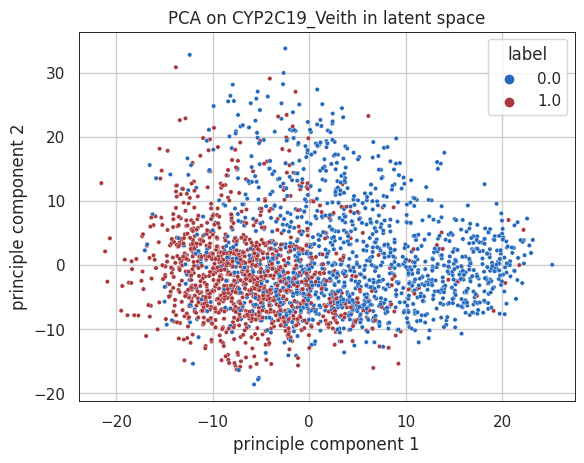

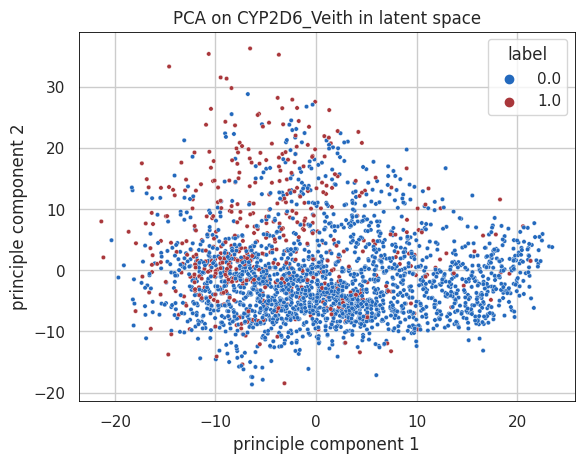

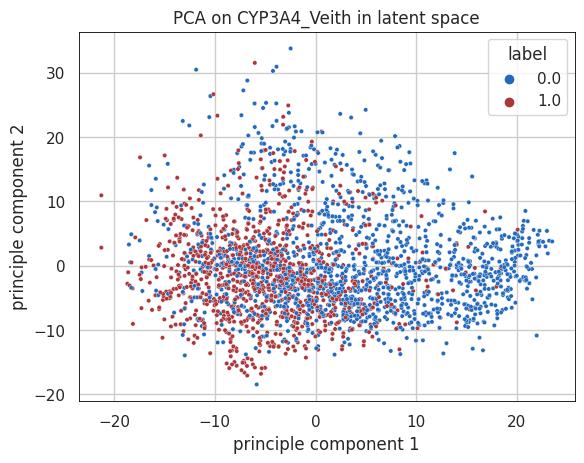

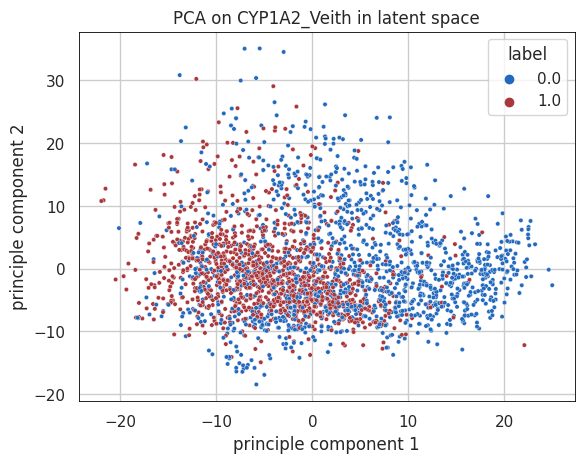

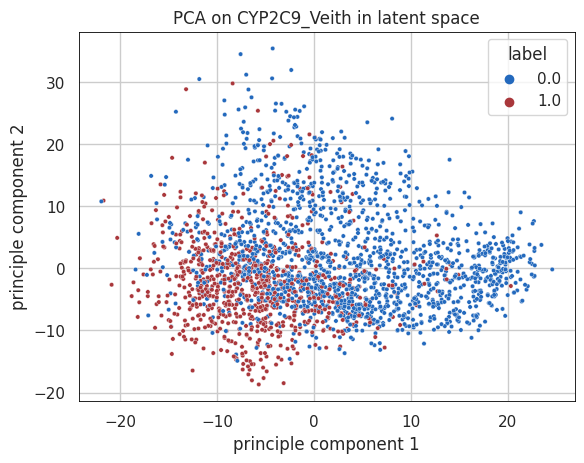

Epoch:30 [Train] Loss: 1.058 | KL Div: 0.036 | Recon: 0.602 | Classify: 0.450 | KL w: 0.150 | cls w: 1.000
Epoch:30 [Valid] Loss: 1.041 | KL Div: 0.031 | Recon: 0.574 | Classify: 0.461 | KL w: 0.150 | cls w: 1.000
# SAVE MODEL: loss: 1.059 -> 1.041 | runtime: 2.598 ms
Train time: 2.572+/-0.027 ms


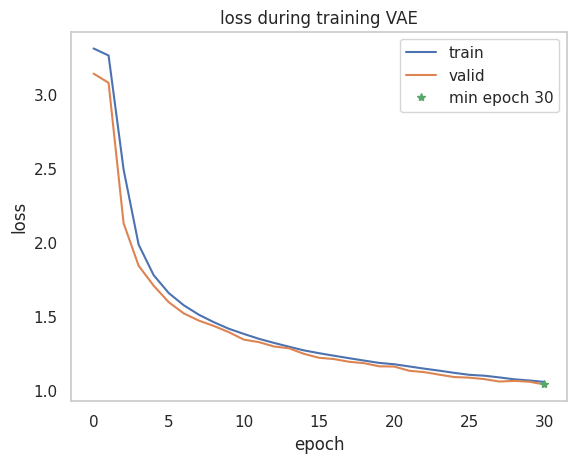

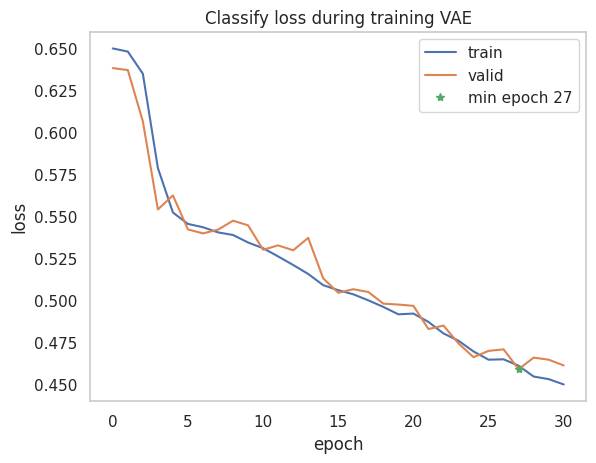

*************** CYP2C19_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.778  &0.783  &0.719  &0.863  &0.703  &0.785 &0.859 &0.570 &0.821

*************** CYP2D6_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.802  &0.500  &  nan  &0.000  &1.000  &  nan &0.767 &  nan &0.460

*************** CYP3A4_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.723  &0.731  &0.638  &0.779  &0.682  &0.702 &0.812 &0.455 &0.740

*************** CYP1A2_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.804  &0.809  &0.750  &0.864  &0.753  &0.803 &0.888 &0.617 &0.855

*************** CYP2C9_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.797  &0.793  &0.677  &0.777  &0.808  &0.724 &0.875 &0.568 &0.777

Epoch:31 [Train] Loss: 1.048 | KL Div: 0.037 | Recon: 0.596 | Classify: 0.446 | KL w: 0.155 | cls w

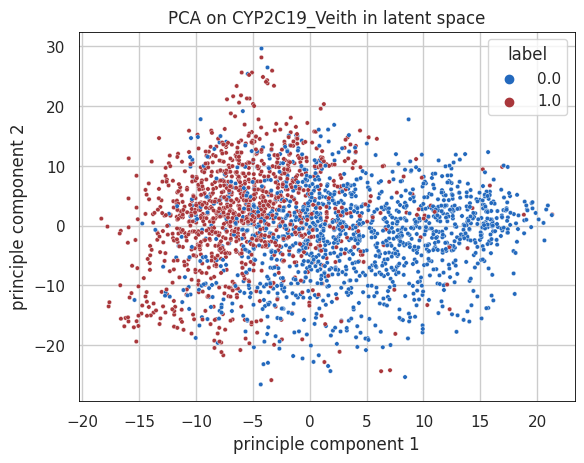

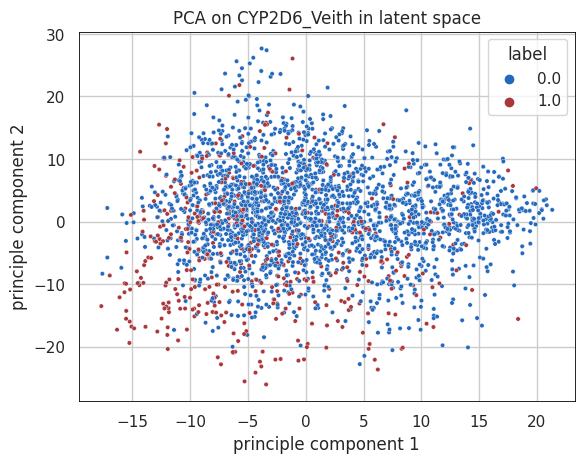

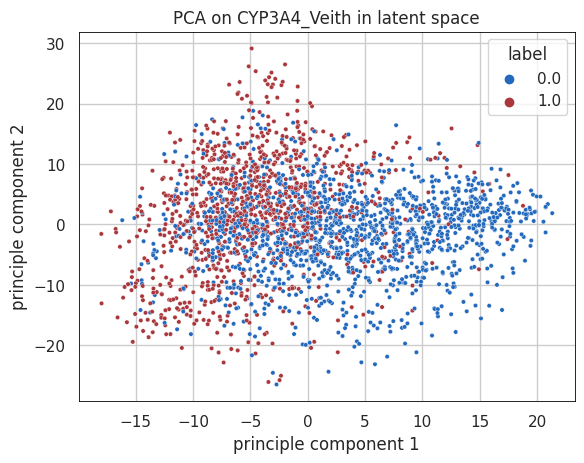

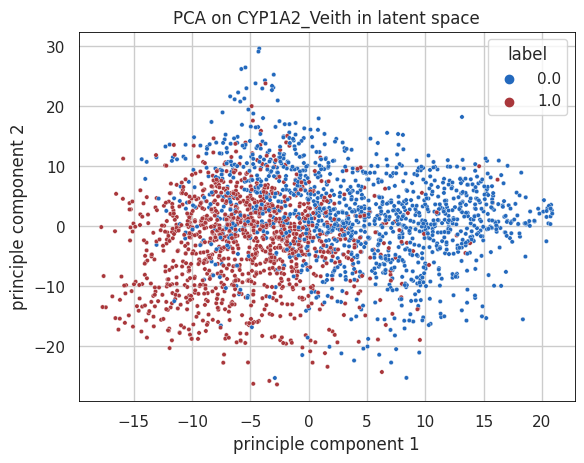

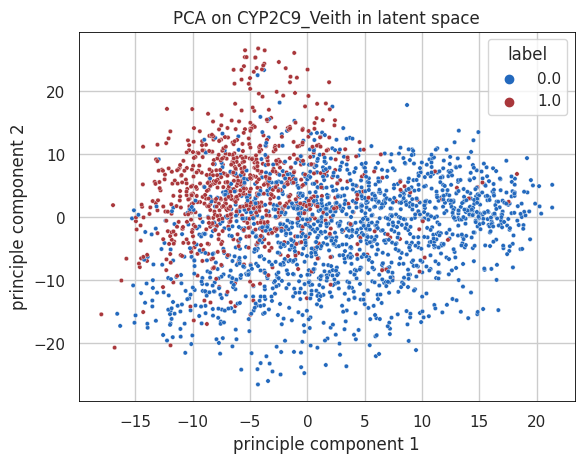

Epoch:40 [Train] Loss: 0.965 | KL Div: 0.034 | Recon: 0.550 | Classify: 0.408 | KL w: 0.200 | cls w: 1.000
Epoch:40 [Valid] Loss: 0.955 | KL Div: 0.027 | Recon: 0.526 | Classify: 0.423 | KL w: 0.200 | cls w: 1.000
## SAVE Enc, Dec, Cls: classify loss: 0.426 -> 0.423 | # SAVE MODEL: loss: 0.959 -> 0.955 | runtime: 2.582 ms
Train time: 2.570+/-0.025 ms


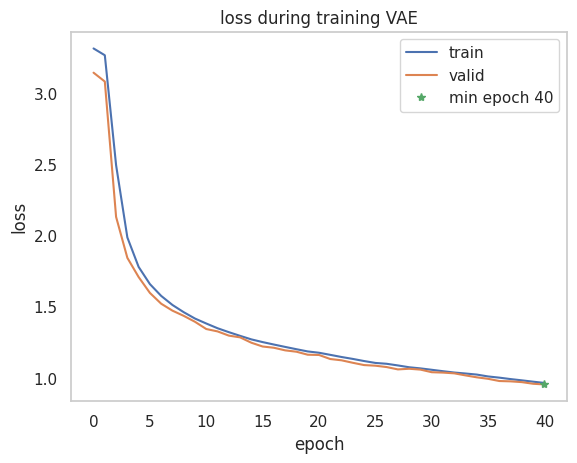

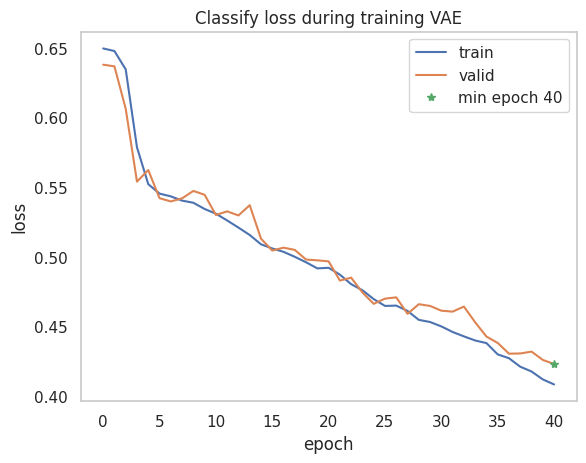

*************** CYP2C19_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.798  &0.796  &0.792  &0.771  &0.822  &0.781 &0.875 &0.593 &0.838

*************** CYP2D6_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.841  &0.646  &0.718  &0.323  &0.969  &0.446 &0.835 &0.408 &0.615

*************** CYP3A4_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.760  &0.749  &0.726  &0.684  &0.815  &0.705 &0.836 &0.503 &0.770

*************** CYP1A2_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.830  &0.831  &0.799  &0.843  &0.818  &0.821 &0.899 &0.660 &0.877

*************** CYP2C9_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.814  &0.772  &0.775  &0.642  &0.903  &0.702 &0.892 &0.574 &0.799

Epoch:41 [Train] Loss: 0.957 | KL Div: 0.034 | Recon: 0.546 | Classify: 0.404 | KL w: 0.205 | cls w

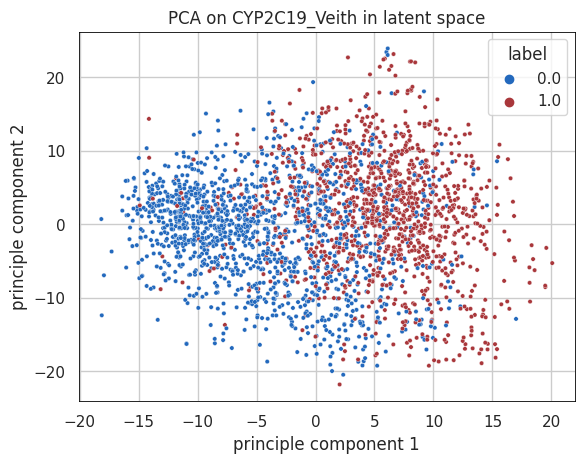

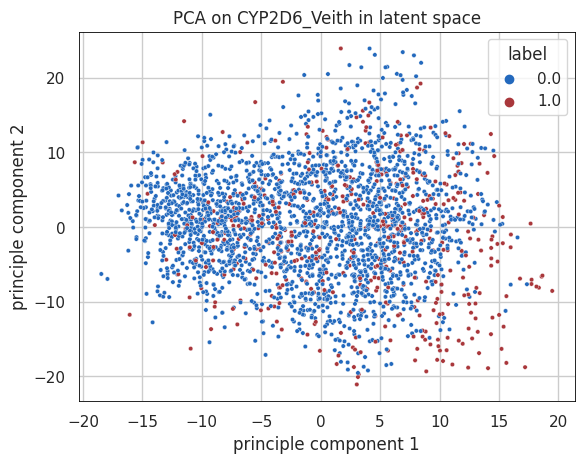

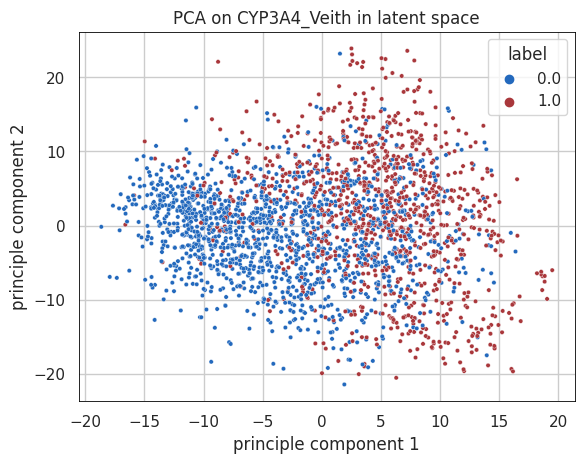

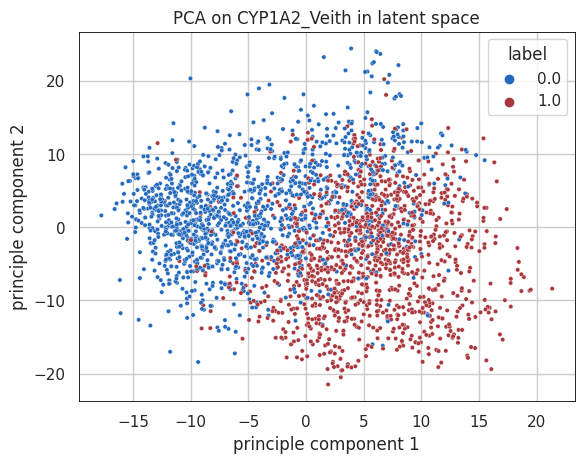

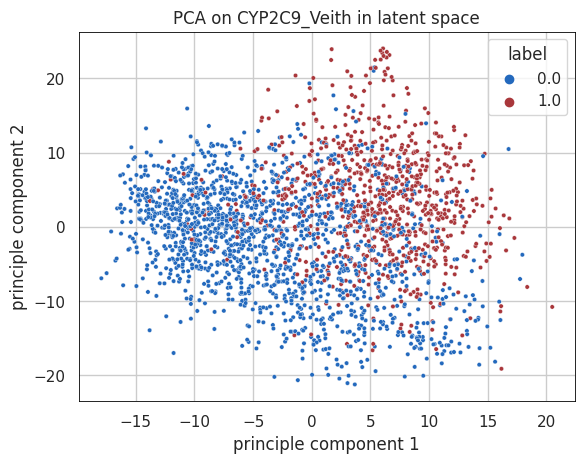

Epoch:50 [Train] Loss: 0.887 | KL Div: 0.031 | Recon: 0.512 | Classify: 0.367 | KL w: 0.250 | cls w: 1.000
Epoch:50 [Valid] Loss: 0.895 | KL Div: 0.027 | Recon: 0.489 | Classify: 0.400 | KL w: 0.250 | cls w: 1.000
## SAVE Enc, Dec, Cls: classify loss: 0.402 -> 0.400 | # SAVE MODEL: loss: 0.902 -> 0.895 | runtime: 2.584 ms
Train time: 2.568+/-0.026 ms


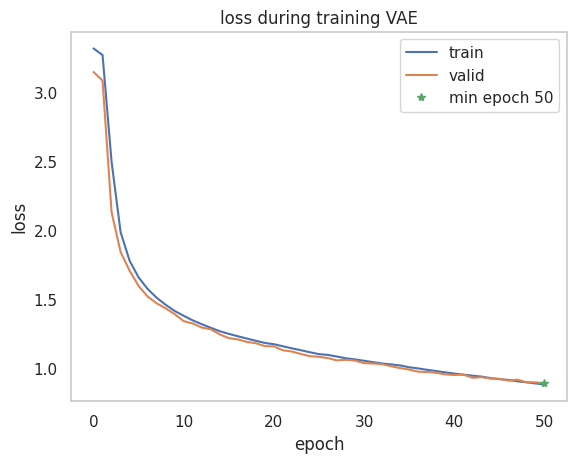

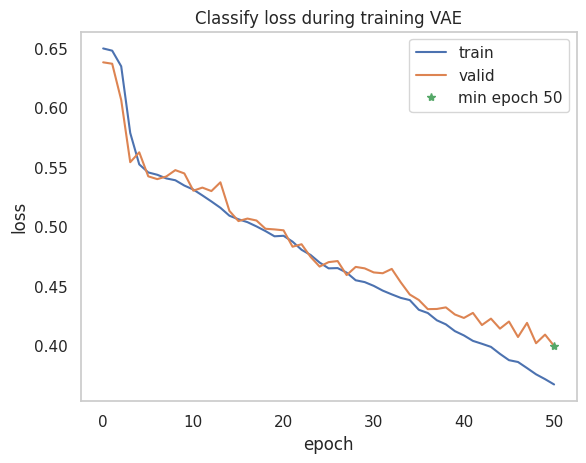

*************** CYP2C19_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.812  &0.810  &0.818  &0.771  &0.848  &0.793 &0.882 &0.622 &0.856

*************** CYP2D6_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.861  &0.707  &0.742  &0.454  &0.961  &0.563 &0.848 &0.507 &0.669

*************** CYP3A4_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.772  &0.758  &0.755  &0.674  &0.842  &0.712 &0.860 &0.527 &0.816

*************** CYP1A2_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.831  &0.833  &0.800  &0.847  &0.818  &0.823 &0.905 &0.663 &0.886

*************** CYP2C9_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.833  &0.811  &0.763  &0.741  &0.881  &0.752 &0.903 &0.626 &0.823

Epoch:51 [Train] Loss: 0.879 | KL Div: 0.032 | Recon: 0.507 | Classify: 0.364 | KL w: 0.255 | cls w

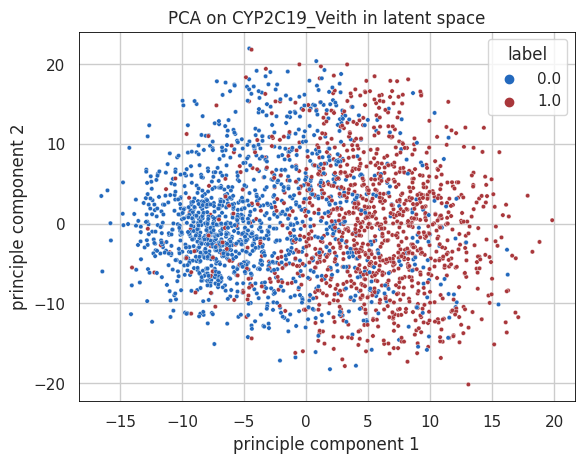

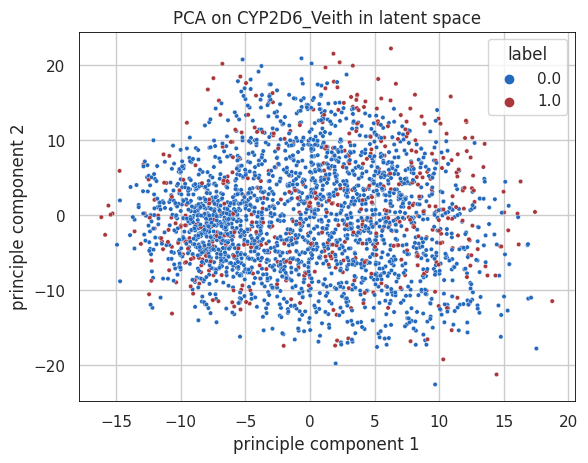

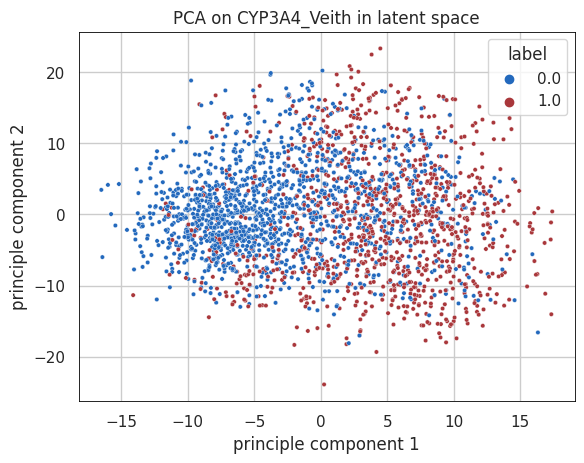

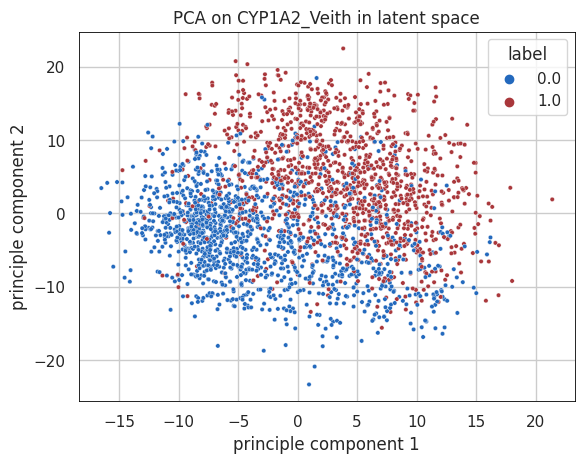

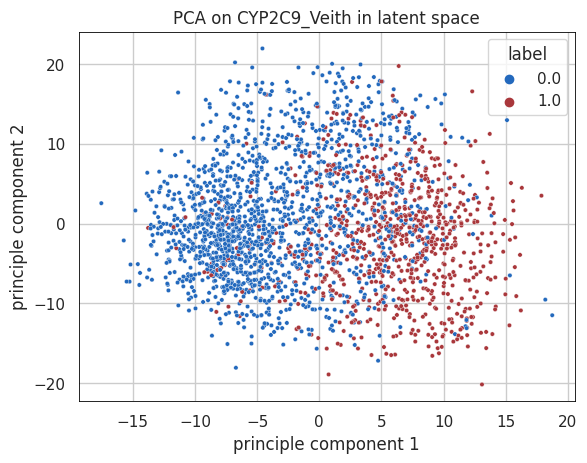

Epoch:60 [Train] Loss: 0.809 | KL Div: 0.034 | Recon: 0.478 | Classify: 0.320 | KL w: 0.300 | cls w: 1.000
Epoch:60 [Valid] Loss: 0.886 | KL Div: 0.031 | Recon: 0.453 | Classify: 0.423 | KL w: 0.300 | cls w: 1.000
EarlyStopping counter: 2 out of 10
Train time: 2.567+/-0.026 ms


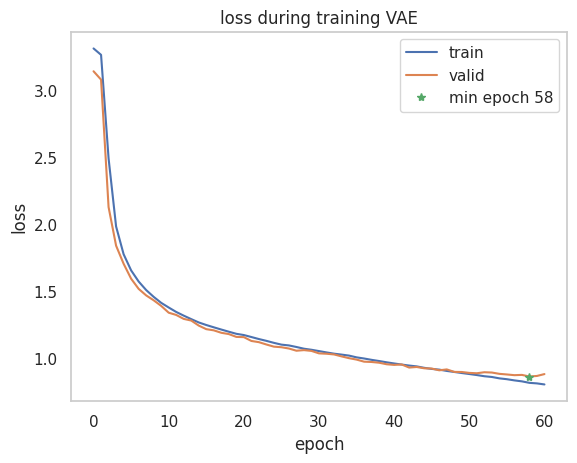

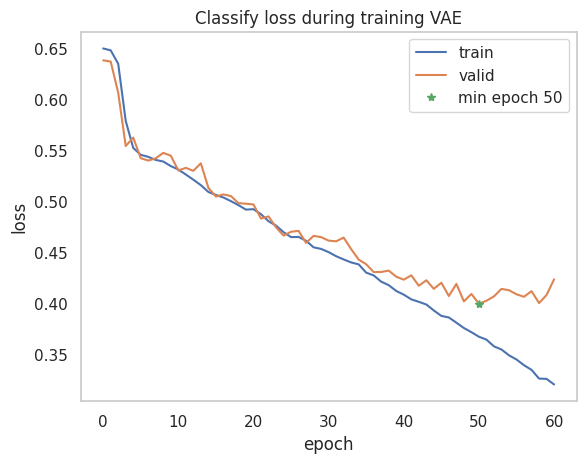

*************** CYP2C19_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.821  &0.819  &0.827  &0.782  &0.856  &0.804 &0.887 &0.641 &0.870

*************** CYP2D6_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.855  &0.722  &0.679  &0.504  &0.941  &0.578 &0.856 &0.501 &0.670

*************** CYP3A4_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.776  &0.768  &0.739  &0.719  &0.817  &0.729 &0.865 &0.538 &0.814

*************** CYP1A2_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.835  &0.833  &0.824  &0.816  &0.851  &0.820 &0.906 &0.667 &0.896

*************** CYP2C9_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.829  &0.803  &0.764  &0.722  &0.884  &0.742 &0.898 &0.615 &0.810

Epoch:61 [Train] Loss: 0.795 | KL Div: 0.033 | Recon: 0.475 | Classify: 0.310 | KL w: 0.305 | cls w

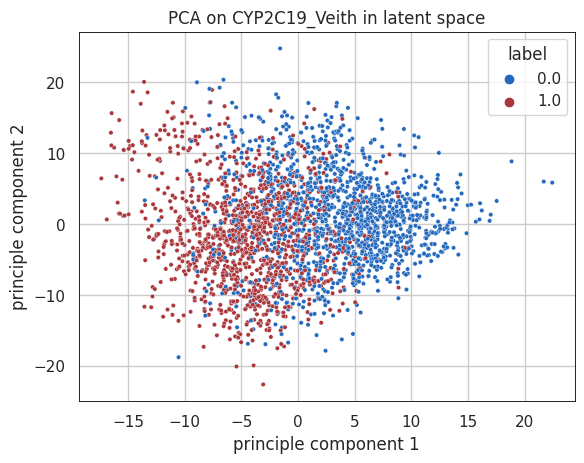

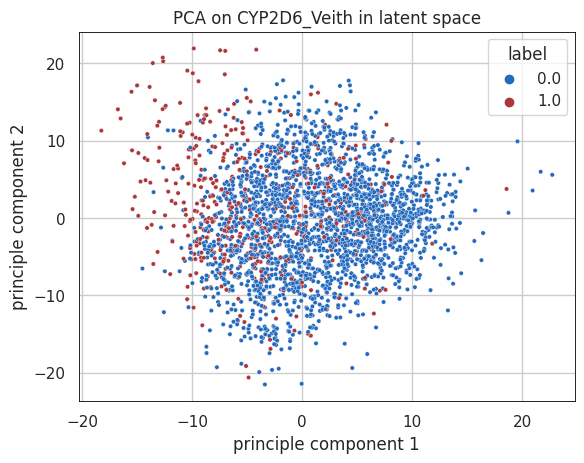

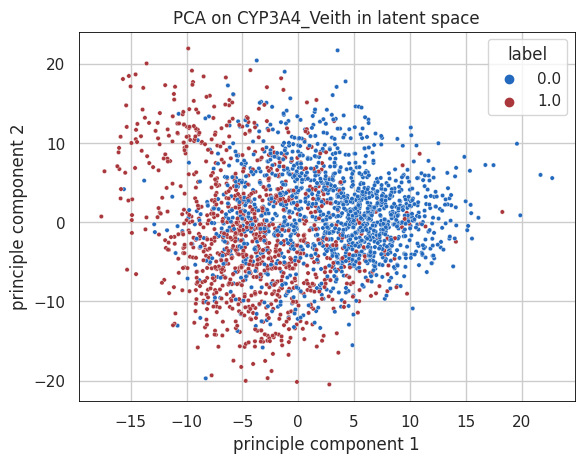

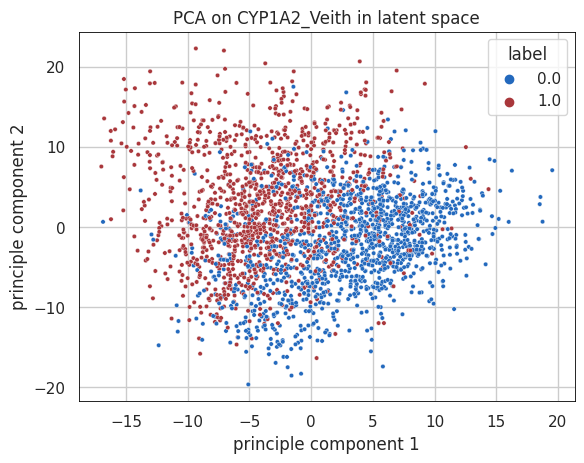

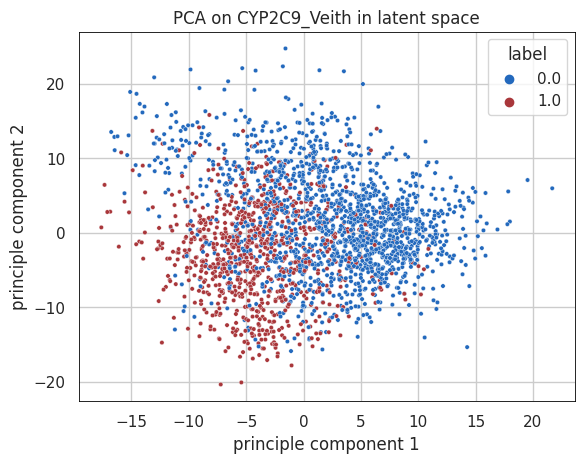

Epoch:70 [Train] Loss: 0.722 | KL Div: 0.034 | Recon: 0.451 | Classify: 0.259 | KL w: 0.350 | cls w: 1.000
Epoch:70 [Valid] Loss: 0.877 | KL Div: 0.033 | Recon: 0.424 | Classify: 0.441 | KL w: 0.350 | cls w: 1.000
EarlyStopping counter: 6 out of 10
Train time: 2.567+/-0.027 ms


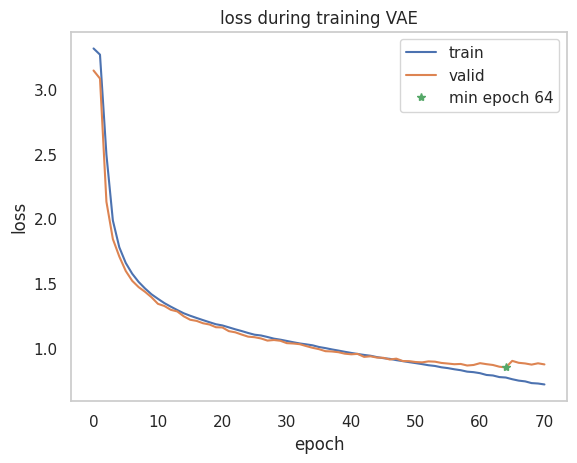

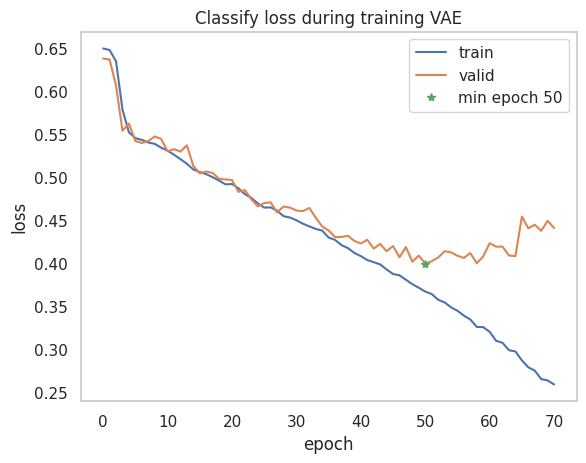

*************** CYP2C19_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.828  &0.826  &0.826  &0.801  &0.851  &0.813 &0.896 &0.654 &0.882

*************** CYP2D6_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.854  &0.725  &0.672  &0.512  &0.938  &0.581 &0.841 &0.501 &0.652

*************** CYP3A4_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.787  &0.778  &0.756  &0.725  &0.831  &0.740 &0.855 &0.560 &0.795

*************** CYP1A2_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.839  &0.838  &0.832  &0.818  &0.858  &0.825 &0.912 &0.677 &0.905

*************** CYP2C9_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.841  &0.829  &0.755  &0.792  &0.867  &0.773 &0.904 &0.651 &0.808

Epoch:71 [Train] Loss: 0.712 | KL Div: 0.034 | Recon: 0.449 | Classify: 0.252 | KL w: 0.355 | cls w

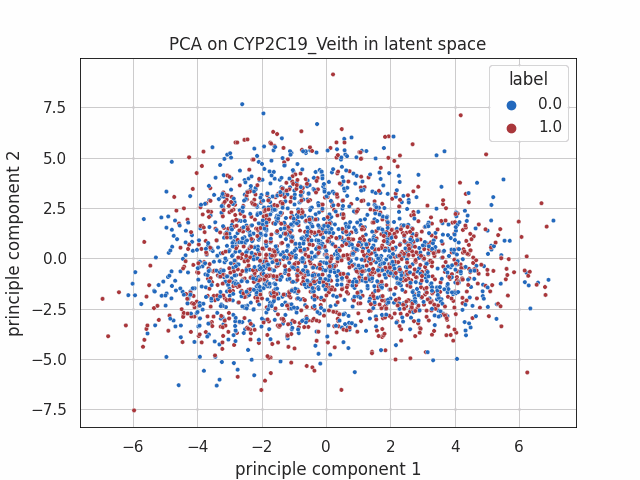

save gif at:  M5/VAE_smiles/fig_CYP2D6_Veith.gif


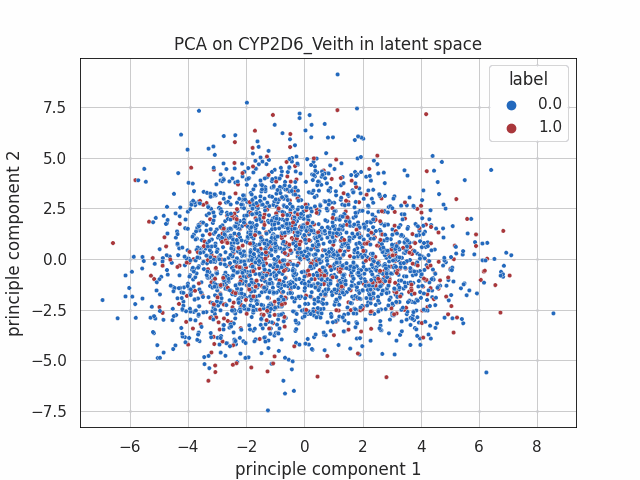

save gif at:  M5/VAE_smiles/fig_CYP3A4_Veith.gif


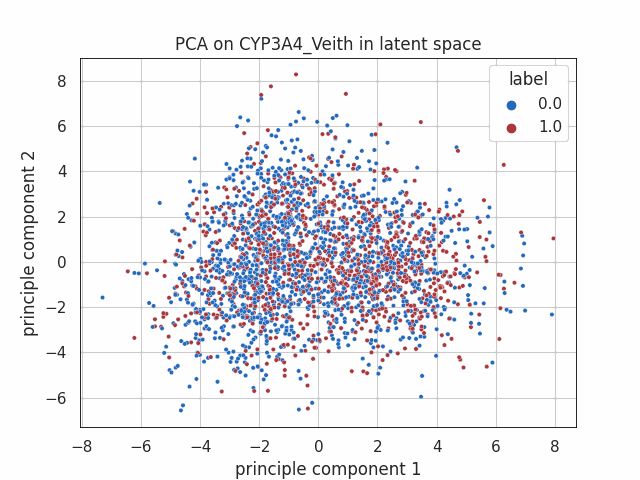

save gif at:  M5/VAE_smiles/fig_CYP1A2_Veith.gif


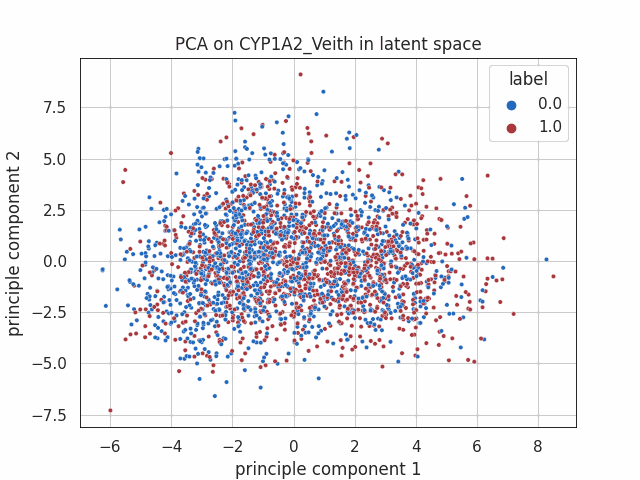

save gif at:  M5/VAE_smiles/fig_CYP2C9_Veith.gif


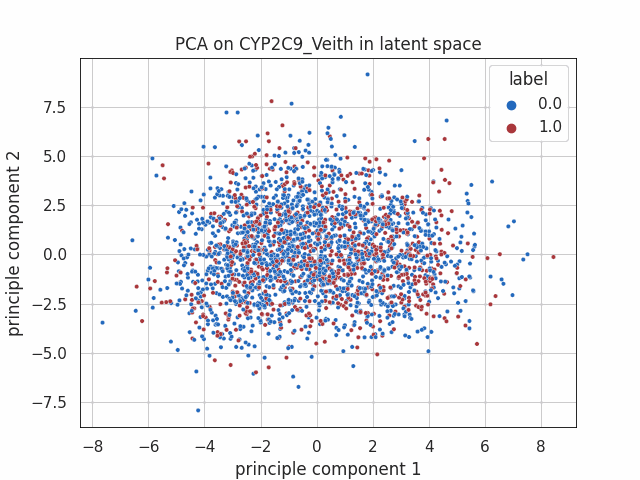


--> Train status saved at M5/VAE_smiles.yml
Model parameters:  7889067
Train time: 2.568+/-0.027 ms
best epoch: 64, min loss: 0.8531


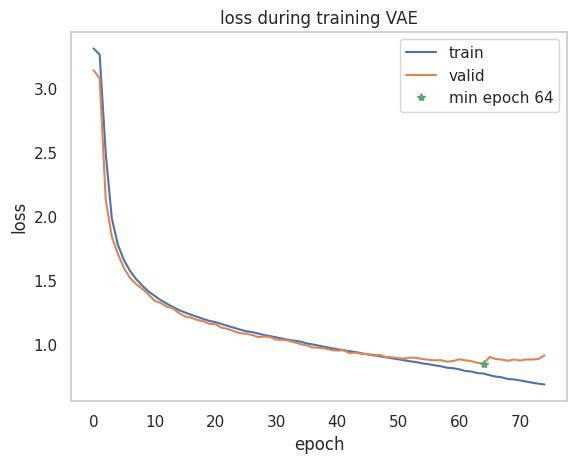

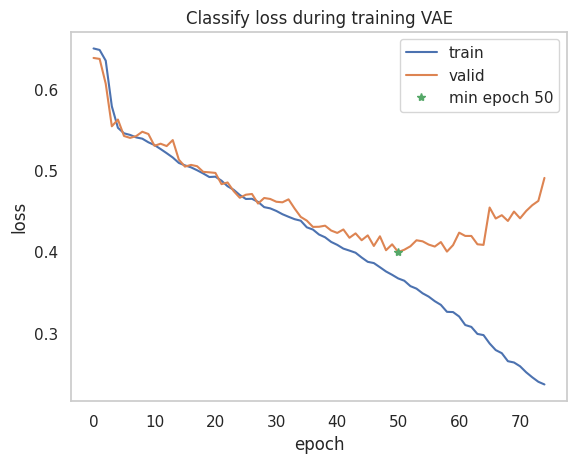

load pretrained model from  M5/VAE_smiles.pt
[Test] Loss: 0.740 | Classify: 0.277
*************** CYP2C19_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.814  &0.816  &0.777  &0.835  &0.796  &0.805 &0.887 &0.629 &0.853


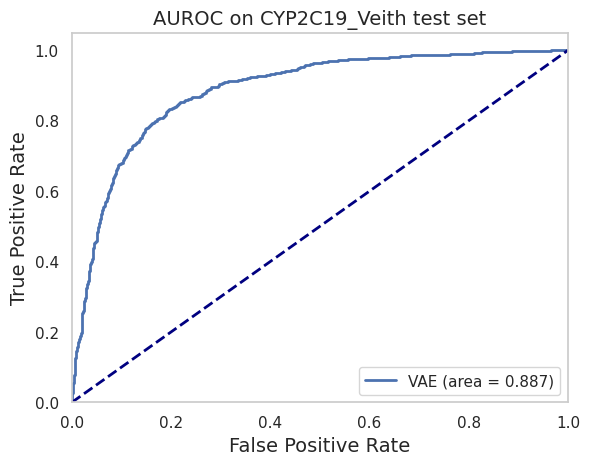

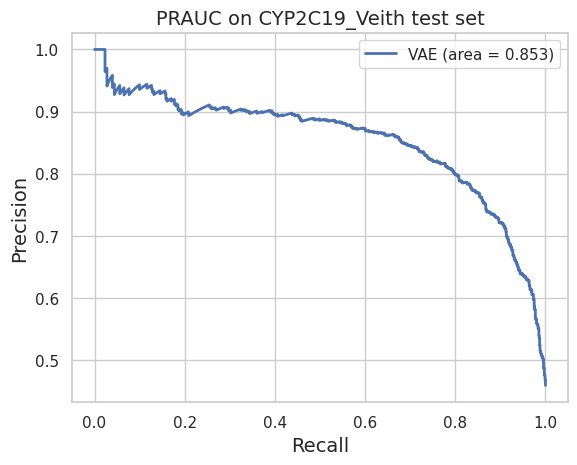


*************** CYP2D6_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.852  &0.694  &0.651  &0.443  &0.946  &0.527 &0.829 &0.455 &0.609


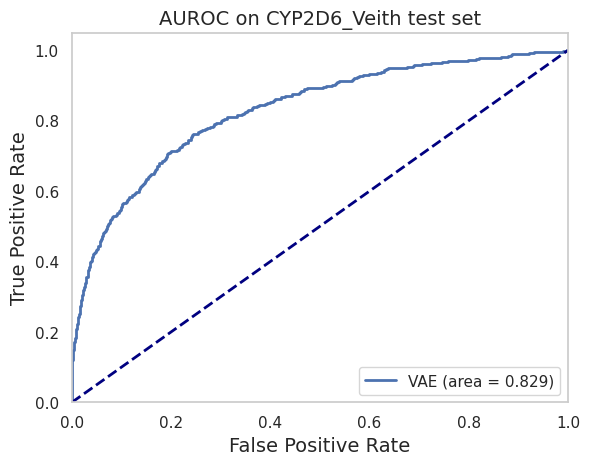

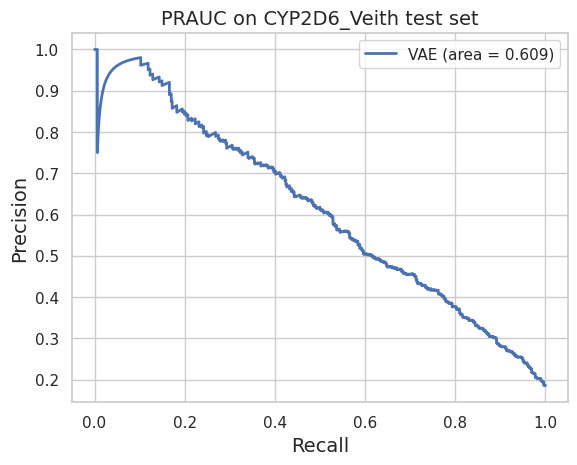


*************** CYP3A4_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.763  &0.761  &0.698  &0.749  &0.772  &0.723 &0.847 &0.517 &0.786


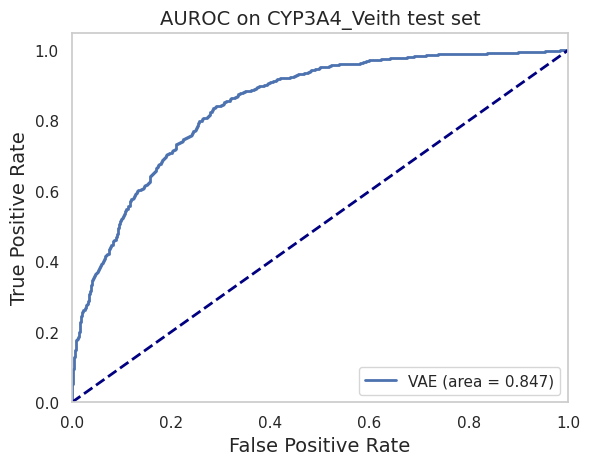

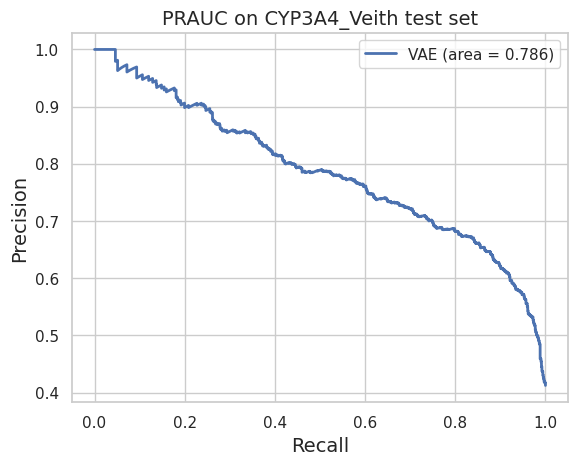


*************** CYP1A2_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.839  &0.841  &0.800  &0.877  &0.804  &0.837 &0.916 &0.681 &0.905


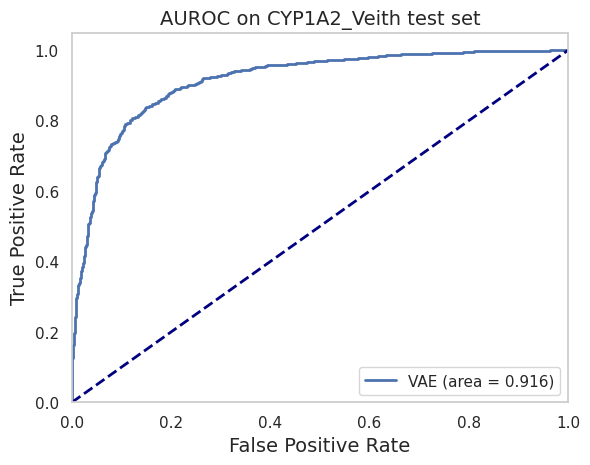

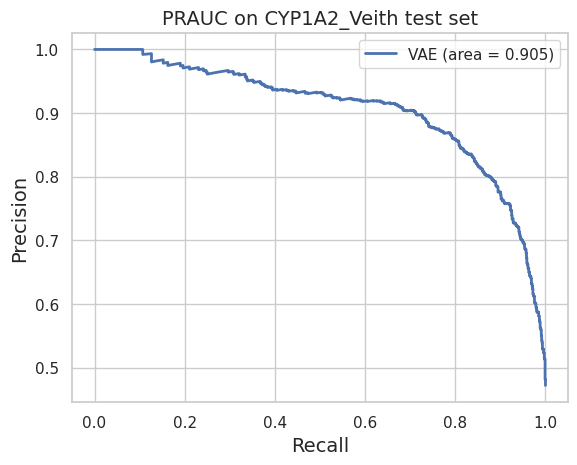


*************** CYP2C9_Veith ***************
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&0.829  &0.812  &0.742  &0.759  &0.865  &0.751 &0.893 &0.621 &0.799


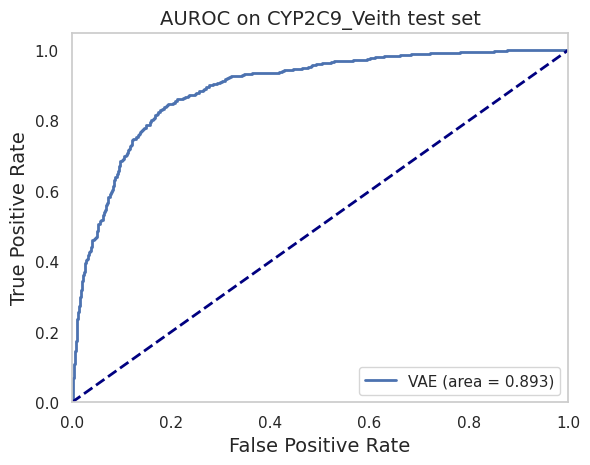

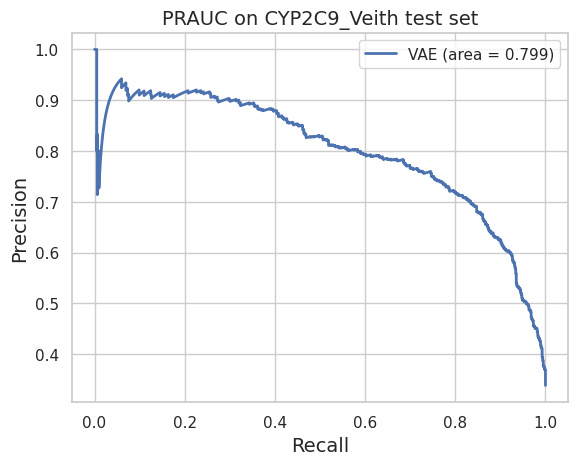



--> Train status saved at M5/VAE_smiles.yml
Finished evaluate test performance, outputs performance dict


In [ ]:
p = models.train(trn_l, val_l, tst_l, tst, len(tst), 1)

In [ ]:
import numpy as np
a = np.nan
print("& %5.3f"%(a))

# a = 12.3423
print(f'  Acc,  w_acc,   prec,  recall,   SP,   ',
          f' F1,    AUC,   MCC,   AP')

print("&%5.3f"%(a), " &%5.3f"%(a),
          " &%5.3f"%(a), " &%5.3f"%(a), " &%5.3f"%(a),
    " &%5.3f"%(a), "&%5.3f"%(a), "&%5.3f"%(a), "&%5.3f"%(a))

&   nan
  Acc,  w_acc,   prec,  recall,   SP,     F1,    AUC,   MCC,   AP
&  nan  &  nan  &  nan  &  nan  &  nan  &  nan &  nan &  nan &  nan


---> load gif from  M5/VAE_smiles/fig_CYP2C19_Veith.gif


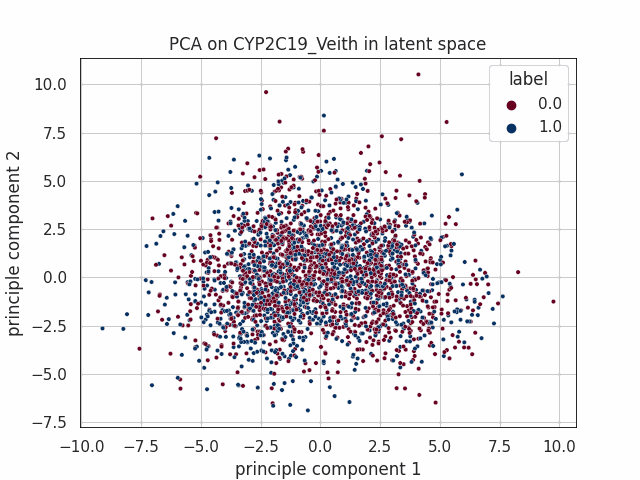

---> load gif from  M5/VAE_smiles/fig_CYP2D6_Veith.gif


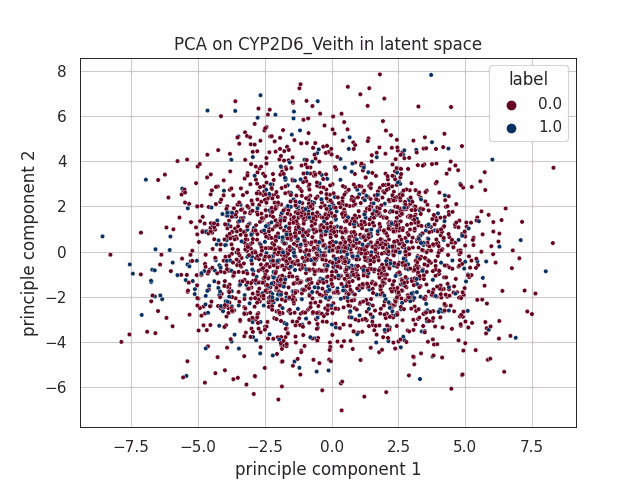

---> load gif from  M5/VAE_smiles/fig_CYP3A4_Veith.gif


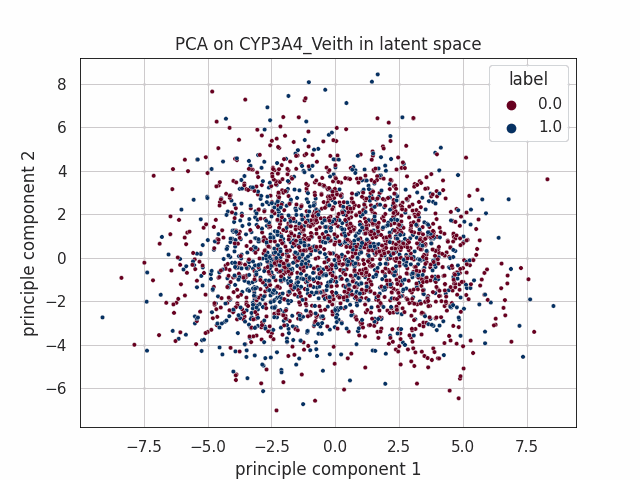

---> load gif from  M5/VAE_smiles/fig_CYP1A2_Veith.gif


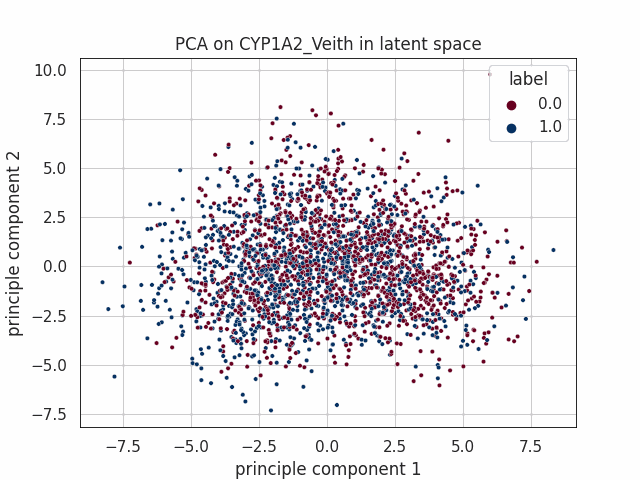

---> load gif from  M5/VAE_smiles/fig_CYP2C9_Veith.gif


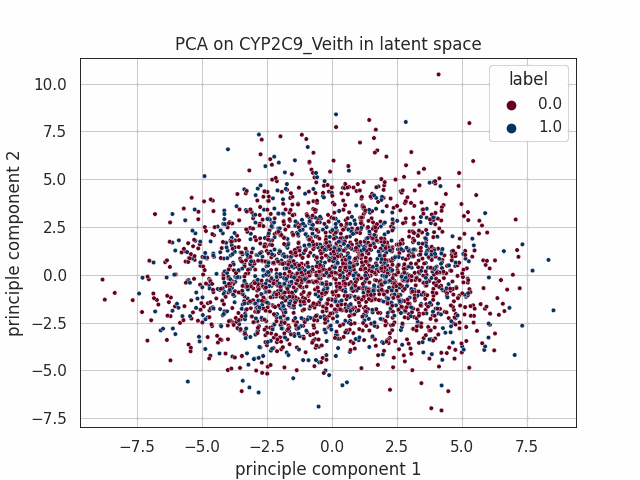

In [ ]:
import imageio

path = config['figure_path']
from os import walk
# files = next(walk(path), (None, None, []))[2]
# files
# for path in ['QED', 'SA']:
# name = ['qed', 'sa']
name = names_M5
for n in name:
    images = []
    for i in range(0,100):
        for j in range(1):
            file_name = path + f'/PCA_{n}_{i}.png'
            # print(file_name)
            try:
                images.append(imageio.imread(file_name))
            except: pass

    imageio.mimsave(f'{path}_{n}.gif', images, duration=1)
    from IPython.display import Image
    gif_path = f'{path}_{n}.gif'
    print('---> load gif from ', gif_path)
    display(Image(data=open(gif_path,'rb').read(), format='png'))